# Import the necessary packages

In [ ]:
import numpy as np
import mrcfile
import matplotlib.pyplot as plt
import glob
import pandas as pd
import cryoblob as cb
import jax
import jax.numpy as jnp

%matplotlib inline
%load_ext autoreload
%autoreload 2

plt.rcParams["image.cmap"] = "magma"

## Clear the font cache, and use Source Family fonts

In [ ]:
!rm -rf ~/.cache/matplotlib
from matplotlib import rcParams

rcParams["font.family"] = ["sans-serif"]
rcParams["font.sans-serif"] = ["Source Sans 3", "Source Sans Pro"]
rcParams["font.serif"] = ["Source Serif 4", "Source Serif Pro"]
rcParams["font.monospace"] = ["Source Code Pro"]
rcParams["font.size"] = 25

# Let's load the files

## Use the file_params to get relative file paths.

In [ ]:
top_level, file_dict = cb.file_params()

### We use glob to find the list of `.mrc` files in the folder.

In [ ]:
plga_la_location = top_level + file_dict["data"]["PLGA_LA"]["Data"]
filetype = "mrc"
file_list = np.asarray(glob.glob(plga_la_location + "*." + filetype), dtype="str")

### Now let's load one dataset. We will load the data into a JAX based PyTree

In [ ]:
test_data = file_list[12]
data_mrc = cb.load_mrc(test_data)

The data_mrc is the PyTree with the following parameters:
- `image_data`: Image array (2D or 3D).
- `voxel_size`: Array containing voxel dimensions in
    Å (Z, Y, X).
- `origin`: Array indicating the origin coordinates from the
    header (Z, Y, X).
- `data_min`: Minimum pixel value.
- `data_max`: Maximum pixel value.
- `data_mean`: Mean pixel value.
- `mode`: Integer code representing data type
    (e.g., 0=int8, 1=int16, 2=float32).

There is an internal function that can directly take in the PyTree, and plot the image with the scalebar and everything.

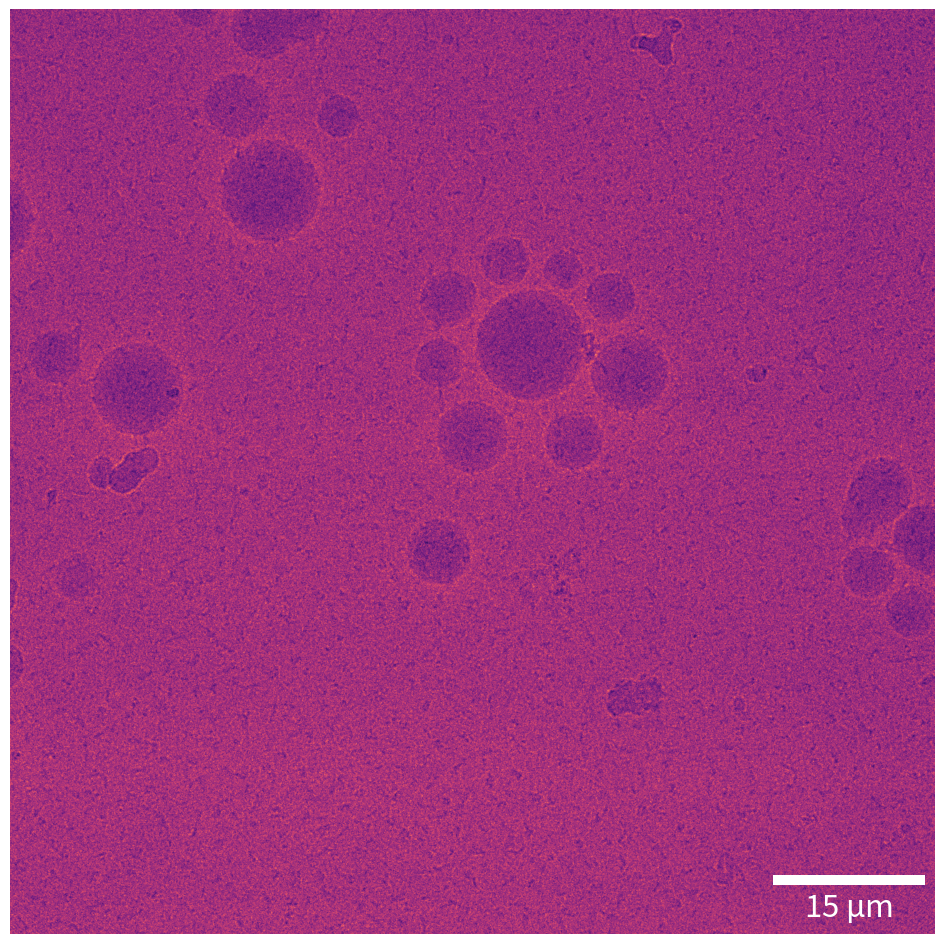

In [ ]:
cb.plot_mrc(data_mrc, (10, 10))

# Working with the data.

One thing, we need to do is to downsample the data a bit, because these datasets are $4096 \times 4096$, and convoluting them with a 96 pixel kernel is computationally needlessly expensive.

<matplotlib.image.AxesImage>

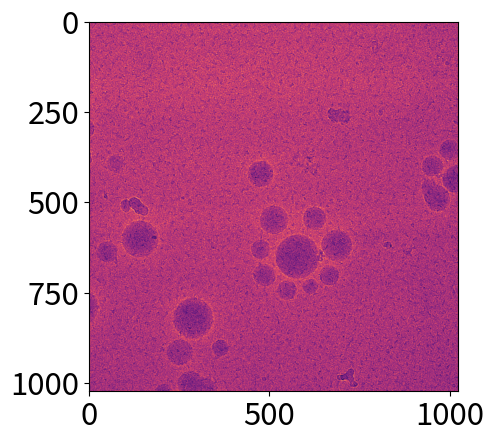

In [ ]:
ds_image = cb.image_resizer(data_mrc.image_data, 4)
plt.imshow(ds_image)

### Noise Removal with Perona Malik Anisotropic Diffusion Filters

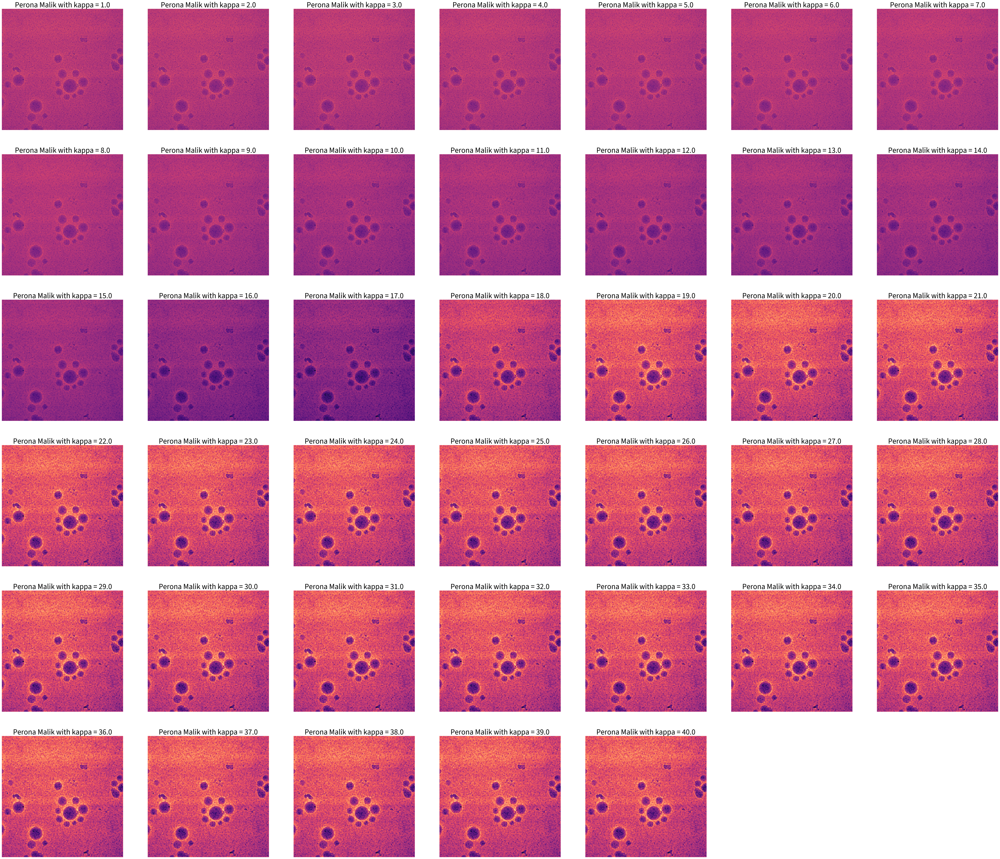

In [ ]:
num_images = 40
multiplicand = 1.0
y = int(np.floor(num_images**0.5))
x = int(np.ceil(num_images/y))
plt.figure(figsize=(10*x, 10*y))
for ii in range(num_images):
    plt.subplot(y, x, ii+1)
    ds_c_image = cb.perona_malik(ds_image, 20, multiplicand*(ii+1))
    plt.imshow(ds_c_image)
    plt.axis("off")
    plt.title("Perona Malik with kappa = " + str(np.round(multiplicand*(ii+1), 1)))
del num_images, y, x, multiplicand, ds_c_image

So, the ideal Perona Malik filter to use is around **19**

#### The `cryoblob` package has the `Laplacian of Gaussian` function. Let's call it to see how fast it runs. Also, remember that the error messages that you are seeing sometimes come from XLA compiler trying to decide on the fastest convolution strategy.

### Calling the function `JIT` compiles it, let's now run it on the image. We use some downsampling (`ds_factor`) to make it faster.

In [ ]:
ds_c_image = cb.perona_malik(ds_image, 20, 19.0)

In [ ]:
plt.figure(figsize=(20, 20))
plt.subplot(2, 2, 1)
plt.imshow(ds_image)
plt.title("Original Image")
plt.axis("off")
plt.subplot(2, 2, 2)
std_val = 10
plt.imshow(cb.laplacian_of_gaussian(ds_c_image, standard_deviation=std_val))
plt.title("Laplacian of Gaussian (std=" + str(std_val) + ")")
plt.axis("off")
plt.subplot(2, 2, 3)
std_val = 20
plt.imshow(cb.laplacian_of_gaussian(ds_c_image, standard_deviation=std_val))
plt.title("Laplacian of Gaussian (std=" + str(std_val) + ")")
plt.axis("off")
plt.subplot(2, 2, 4)
std_val = 30
plt.imshow(cb.laplacian_of_gaussian(ds_c_image, standard_deviation=std_val))
plt.title("Laplacian of Gaussian (std=" + str(std_val) + ")")
plt.axis("off")

2025-04-07 19:42:42.467595: E external/xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng1{k2=4,k3=0} for conv (f64[1,1,1024,1024]{3,2,1,0}, u8[0]{0}) custom-call(f64[1,1,1225,1225]{3,2,1,0}, f64[1,1,202,202]{3,2,1,0}), window={size=202x202}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convForward", backend_config={"operation_queue_id":"0","wait_on_operation_queues":[],"cudnn_conv_backend_config":{"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0},"force_earliest_schedule":false} is taking a while...


In [ ]:
plt.figure(figsize=(20, 30))
plt.subplot(3, 2, 1)
std_val = 10
plt.imshow(cb.laplacian_of_gaussian(ds_image, standard_deviation=std_val))
plt.title("No Perona-Malik Laplacian of Gaussian (std=" + str(std_val) + ")")
plt.axis("off")
plt.subplot(3, 2, 2)
std_val = 10
plt.imshow(cb.laplacian_of_gaussian(ds_c_image, standard_deviation=std_val))
plt.title("Laplacian of Gaussian (std=" + str(std_val) + ")")
plt.axis("off")
plt.subplot(3, 2, 3)
std_val = 20
plt.imshow(cb.laplacian_of_gaussian(ds_image, standard_deviation=std_val))
plt.title("No Perona-Malik Laplacian of Gaussian (std=" + str(std_val) + ")")
plt.axis("off")
plt.subplot(3, 2, 4)
std_val = 20
plt.imshow(cb.laplacian_of_gaussian(ds_c_image, standard_deviation=std_val))
plt.title("Laplacian of Gaussian (std=" + str(std_val) + ")")
plt.axis("off")
plt.subplot(3, 2, 5)
std_val = 30
plt.imshow(cb.laplacian_of_gaussian(ds_image, standard_deviation=std_val))
plt.title("No Perona-Malik Laplacian of Gaussian (std=" + str(std_val) + ")")
plt.axis("off")
plt.subplot(3, 2, 6)
std_val = 30
plt.imshow(cb.laplacian_of_gaussian(ds_c_image, standard_deviation=std_val))
plt.title("Laplacian of Gaussian (std=" + str(std_val) + ")")
plt.axis("off")

As we can observe modifying the *standard deviation* selectively brightens the blobs, whose radius closely matches the standard deviation. This is the principle behind blob detection by the **Laplacian of Gaussians** approach - perform a series of convolutions - and then run gaussian peak fitting to locate the blob radii.

### Now, we will run the `cryoblob.blob_list` to JIT compile it, and see how it runs through a series of Standard Deviations and locates the blobs

In [ ]:
cb.blob_list_log(data_mrc, downscale=4)

TypeError: reduce_window() got an unexpected keyword argument 'computation_fn'

In [ ]:
calculated_blob_pos = arm_em.blob_list(im_data, downscale=7).get()
circle_test = np.zeros_like(im_data.get())
yy, xx = np.mgrid[0 : circle_test.shape[0], 0 : circle_test.shape[1]]
for jj in trange(len(calculated_blob_pos)):
    circle_test += (
        ((yy - calculated_blob_pos[jj, 0]) ** 2)
        + ((xx - calculated_blob_pos[jj, 1]) ** 2)
    ) < (calculated_blob_pos[jj, 2] ** 2)
del yy, xx, jj

### Let's plot the locations and sizes of the blobs. You will notice the blob sizes are still not correct!

In [ ]:
plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
plt.imshow(im_data.get())
plt.scatter(calculated_blob_pos[:, 1], calculated_blob_pos[:, 0], c="r")
plt.subplot(1, 2, 2)
plt.imshow(circle_test)
plt.savefig(top_level + file_dict["results"]["PLGA_LA"] + "Figure_test.png")

### Let's save the calculated data for this single image to a CSV file

In [ ]:
calculated_blobs = pd.DataFrame(
    data=calculated_blob_pos, columns=["Center Y (nm)", "Center X (nm)", "Size (nm)"]
)
calculated_blobs.to_csv(
    path_or_buf=top_level + file_dict["results"]["PLGA_LA"] + "Blob_Test.csv"
)
calculated_blobs